Nou còdec: zlib
    
Còdecs: blosclz, zstd i lz4
    
CONCLUSIONS: lz4 se solape un poc en blosclz. Prediu bé molt poquetes de lz4.

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import plotly.express as px
import numpy as np
import aux_funcs

In [2]:
from pathlib import Path
path = Path('../data_inputs_temp/')

In [3]:
ficheros = ['entropy-shuffle', 'blosclz-shuffle-split', 'zstd-shuffle-split', 'lz4-shuffle-split']
categories = ["30", "0", "1", "2"]

dataframes1 = {}
for i in range(len(ficheros)):
    dataframes1[ficheros[i]] = aux_funcs.get_filtered_df(path, ficheros[i], category=categories[i])

In [4]:
path = Path('../data_inputs')

dataframes2 = {}
for i in range(len(ficheros)):
    dataframes2[ficheros[i]] = aux_funcs.get_filtered_df(path, ficheros[i], category=categories[i])

In [5]:
path = Path('../data_inputs_wind/')

dataframes3 = {}
for i in range(len(ficheros)):
    dataframes3[ficheros[i]] = aux_funcs.get_filtered_df(path, ficheros[i], category=categories[i])

In [6]:
df_fig = pd.DataFrame()
for i in range(0, len(ficheros)):
    df_fig = pd.concat([df_fig, dataframes1[ficheros[i]]], axis = 0)
    df_fig = pd.concat([df_fig, dataframes2[ficheros[i]]], axis = 0)
    df_fig = pd.concat([df_fig, dataframes3[ficheros[i]]], axis = 0)

df_fig

,cratio,speed,special_vals,nchunk,category,codec_filter,categoria
0,16400.00,5.410000e+09,1,0,-1,entropy-shuffle,30
1,2.02,2.340000e+09,0,0,-1,entropy-shuffle,30
2,5.73,5.700000e+09,0,0,-1,entropy-shuffle,30
3,13100.00,5.410000e+09,1,0,-1,entropy-shuffle,30
4,16400.00,5.410000e+09,1,0,-1,entropy-shuffle,30
...,...,...,...,...,...,...,...
55291,16400.00,5.560000e+09,1,215,4,lz4-shuffle-split,2
55292,16400.00,5.560000e+09,1,215,4,lz4-shuffle-split,2
55293,16400.00,5.560000e+09,1,215,4,lz4-shuffle-split,2
55294,16400.00,5.600000e+09,1,215,4,lz4-shuffle-split,2


In [7]:
df_fig = df_fig[df_fig['special_vals'] == 0]

In [8]:
fig = px.scatter(df_fig, "cratio", "speed", color = "categoria")
fig.show()

0: blosclz

1: zstd

2: lz4

# DATAFRAME FILTRE shuffle

In [9]:
df_entropy = pd.DataFrame()
df_entropy = pd.concat([df_entropy, dataframes1[ficheros[0]], dataframes2[ficheros[0]], 
                       dataframes3[ficheros[0]]], axis = 0)

df_entropy.rename(columns = {'cratio':'cratio31', 'speed':'speed31', 'special_vals':'special_vals31'}, inplace = True)
df_entropy = df_entropy.drop(['nchunk', 'category', 'codec_filter', 'categoria'], axis = 1)

In [10]:
df_blosclz = pd.DataFrame()
df_blosclz = pd.concat([df_blosclz, dataframes1[ficheros[1]], dataframes2[ficheros[1]], 
                       dataframes3[ficheros[1]]], axis = 0)

df_blosclz.rename(columns = {'cratio':'cratio0', 'speed':'speed0', 'special_vals':'special_vals0'}, inplace = True)
df_blosclz = df_blosclz.drop(['nchunk', 'category', 'codec_filter', 'categoria'], axis = 1)

In [11]:
df_zstd = pd.DataFrame()
df_zstd = pd.concat([df_zstd, dataframes1[ficheros[2]], dataframes2[ficheros[2]], 
                        dataframes3[ficheros[2]]], axis = 0)

df_zstd.rename(columns = {'cratio':'cratio1', 'speed':'speed1', 'special_vals':'special_vals1'}, inplace = True)
df_zstd = df_zstd.drop(['nchunk', 'category', 'codec_filter', 'categoria'], axis = 1)

In [12]:
df_lz4 = pd.DataFrame()
df_lz4 = pd.concat([df_lz4, dataframes1[ficheros[3]], dataframes2[ficheros[3]], 
                        dataframes3[ficheros[3]]], axis = 0)

df_lz4.rename(columns = {'cratio':'cratio2', 'speed':'speed2', 'special_vals':'special_vals2'}, inplace = True)
df_lz4 = df_lz4.drop(['nchunk', 'category', 'codec_filter', 'categoria'], axis = 1)

In [13]:
df_shuffle = pd.DataFrame()
df_shuffle = pd.concat([df_shuffle, df_blosclz, df_zstd, df_lz4, df_entropy], axis = 1)
df_shuffle

,cratio0,speed0,special_vals0,cratio1,speed1,special_vals1,cratio2,speed2,special_vals2,cratio31,speed31,special_vals31
0,16400.00,5.210000e+09,1,16400.0,5.520000e+09,1,16400.00,5.540000e+09,1,16400.00,5.410000e+09,1
1,2.28,1.700000e+08,0,4.9,6.950000e+06,0,1.96,1.740000e+08,0,2.02,2.340000e+09,0
2,5.76,4.090000e+08,0,17.1,1.850000e+07,0,4.94,3.590000e+08,0,5.73,5.700000e+09,0
3,13100.00,5.210000e+09,1,13100.0,5.520000e+09,1,13100.00,5.560000e+09,1,13100.00,5.410000e+09,1
4,16400.00,5.230000e+09,1,16400.0,5.540000e+09,1,16400.00,5.580000e+09,1,16400.00,5.410000e+09,1
...,...,...,...,...,...,...,...,...,...,...,...,...
55291,16400.00,5.580000e+09,1,16400.0,5.580000e+09,1,16400.00,5.560000e+09,1,16400.00,5.410000e+09,1
55292,16400.00,5.580000e+09,1,16400.0,5.460000e+09,1,16400.00,5.560000e+09,1,16400.00,5.310000e+09,1
55293,16400.00,5.580000e+09,1,16400.0,5.440000e+09,1,16400.00,5.560000e+09,1,16400.00,5.540000e+09,1
55294,16400.00,5.580000e+09,1,16400.0,5.460000e+09,1,16400.00,5.600000e+09,1,16400.00,5.580000e+09,1


Eliminar special_value (que lo sea en alguna de las 4 categorías)

In [14]:
df_shuffle = aux_funcs.delete_special_vals(df_shuffle, ["special_vals0", "special_vals1", "special_vals31"])

In [15]:
df_input_x = df_shuffle.iloc[:, [9, 10]]

In [16]:
df_input_x

,cratio31,speed31
1,2.02,2.340000e+09
2,5.73,5.700000e+09
5,2.11,2.700000e+09
6,6.10,6.340000e+09
9,2.23,2.710000e+09
...,...,...
55203,21.80,1.440000e+10
55206,3.70,4.770000e+09
55207,19.00,1.380000e+10
55210,3.99,5.190000e+09


Cálculo del SCORE

In [17]:
df_shuffle = df_shuffle.drop(['cratio31', 'speed31', 'special_vals31', 'special_vals0', 'special_vals1', 'special_vals2'], axis = 1)

In [18]:
df_shuffle

,cratio0,speed0,cratio1,speed1,cratio2,speed2
1,2.28,1.700000e+08,4.90,6950000.0,1.96,1.740000e+08
2,5.76,4.090000e+08,17.10,18500000.0,4.94,3.590000e+08
5,2.29,1.760000e+08,4.95,7130000.0,1.96,1.750000e+08
6,5.81,4.310000e+08,18.20,19600000.0,5.01,3.690000e+08
9,2.35,1.840000e+08,5.17,7130000.0,2.00,1.800000e+08
...,...,...,...,...,...,...
55203,48.70,2.400000e+09,152.00,64000000.0,44.40,1.770000e+09
55206,6.33,4.540000e+08,13.30,25300000.0,7.32,4.940000e+08
55207,50.20,2.460000e+09,148.00,62000000.0,43.50,1.770000e+09
55210,14.30,9.870000e+08,29.90,61200000.0,16.10,9.040000e+08


In [19]:
dfcratios = pd.DataFrame()
for i in range(0, 3):
    dfcratios = pd.concat([dfcratios, df_shuffle.iloc[:, 2*i]], axis =0)

In [20]:
desv_cratio = dfcratios.std()[0]
desv_cratio

198.49911561713222

In [21]:
mean_cratio = dfcratios.mean()[0]
mean_cratio

40.16907479413966

In [22]:
dfspeeds = pd.DataFrame()
for i in range(0, 3):
    dfspeeds = pd.concat([dfspeeds, df_shuffle.iloc[:, 2*i+1]], axis =0)

In [23]:
mean_speed = dfspeeds.mean()[0]
mean_speed

548103770.6341568

In [24]:
desv_speed = dfspeeds.std()[0]
desv_speed

941414672.305214

In [25]:
theta = 0.89

cratio0 = df_shuffle["cratio0"]
speed0 = df_shuffle["speed0"]
ncratio0 = (cratio0 - mean_cratio) / desv_cratio
nspeed0 = (speed0 - mean_speed) / desv_speed
df_shuffle.insert(2, 0, theta*ncratio0 + (1-theta)*nspeed0)

cratio1 = df_shuffle["cratio1"]
speed1 = df_shuffle["speed1"]
ncratio1 = (cratio1 - mean_cratio) / desv_cratio
nspeed1 = (speed1 - mean_speed) / desv_speed
df_shuffle.insert(5, 1, theta*ncratio1 + (1-theta)*nspeed1)

cratio2 = df_shuffle["cratio2"]
speed2 = df_shuffle["speed2"]
ncratio2 = (cratio2 - mean_cratio) / desv_cratio
nspeed2 = (speed2 - mean_speed) / desv_speed
df_shuffle.insert(8, 2, theta*ncratio2 + (1-theta)*nspeed2)

In [26]:
df_shuffle

,cratio0,speed0,0,cratio1,speed1,1,cratio2,speed2,2
1,2.28,1.700000e+08,-0.214061,4.90,6950000.0,-0.221365,1.96,1.740000e+08,-0.215028
2,5.76,4.090000e+08,-0.170532,17.10,18500000.0,-0.165315,4.94,3.590000e+08,-0.180051
5,2.29,1.760000e+08,-0.213315,4.95,7130000.0,-0.221120,1.96,1.750000e+08,-0.214911
6,5.81,4.310000e+08,-0.167737,18.20,19600000.0,-0.160255,5.01,3.690000e+08,-0.178568
9,2.35,1.840000e+08,-0.212111,5.17,7130000.0,-0.220134,2.00,1.800000e+08,-0.214148
...,...,...,...,...,...,...,...,...,...
55203,48.70,2.400000e+09,0.254635,152.00,64000000.0,0.444845,44.40,1.770000e+09,0.161743
55206,6.33,4.540000e+08,-0.162718,13.30,25300000.0,-0.181559,7.32,4.940000e+08,-0.153605
55207,50.20,2.460000e+09,0.268371,148.00,62000000.0,0.426677,43.50,1.770000e+09,0.157708
55210,14.30,9.870000e+08,-0.064705,29.90,61200000.0,-0.102935,16.10,9.040000e+08,-0.066332


In [27]:
df_pos = df_shuffle
df_pos = df_pos.drop(['cratio0', 'speed0', 'cratio1', 'speed1', 'cratio2', 'speed2'], axis = 1)

In [28]:
df_pos

,0,1,2
1,-0.214061,-0.221365,-0.215028
2,-0.170532,-0.165315,-0.180051
5,-0.213315,-0.221120,-0.214911
6,-0.167737,-0.160255,-0.178568
9,-0.212111,-0.220134,-0.214148
...,...,...,...
55203,0.254635,0.444845,0.161743
55206,-0.162718,-0.181559,-0.153605
55207,0.268371,0.426677,0.157708
55210,-0.064705,-0.102935,-0.066332


EJERCICIO TOIA

In [29]:
col = df_pos.iloc[:, 0]
df = col.to_frame(name='punct')
df

df_0 = pd.DataFrame()
df_0 = pd.concat([df_0, df], axis = 0)
categoria = np.repeat(str(0), 77925)
df_0['categoria'] = categoria
df_0

,punct,categoria
1,-0.214061,0
2,-0.170532,0
5,-0.213315,0
6,-0.167737,0
9,-0.212111,0
...,...,...
55203,0.254635,0
55206,-0.162718,0
55207,0.268371,0
55210,-0.064705,0


In [30]:
col = df_pos.iloc[:, 1]
df = col.to_frame(name='punct')
df

df_1 = pd.DataFrame()
df_1 = pd.concat([df_1, df], axis = 0)
categoria = np.repeat('1', 77925)
df_1['categoria'] = categoria
df_1

,punct,categoria
1,-0.221365,1
2,-0.165315,1
5,-0.221120,1
6,-0.160255,1
9,-0.220134,1
...,...,...
55203,0.444845,1
55206,-0.181559,1
55207,0.426677,1
55210,-0.102935,1


In [31]:
df_fig = pd.DataFrame()
df_fig = pd.concat([df_fig, df_0, df_1], axis = 0)
df_fig

,punct,categoria
1,-0.214061,0
2,-0.170532,0
5,-0.213315,0
6,-0.167737,0
9,-0.212111,0
...,...,...
55203,0.444845,1
55206,-0.181559,1
55207,0.426677,1
55210,-0.102935,1


In [32]:
fig = px.scatter(df_fig, "punct", "categoria", color = "categoria")
fig.show()

FIN EJERCICIO

In [33]:
best_categ_shuffle = df_pos.idxmax(axis=1)
best_categ_shuffle = pd.DataFrame(best_categ_shuffle, columns=['best_categ'])
best_categ_shuffle

,best_categ
1,0
2,1
5,0
6,1
9,0
...,...
55203,1
55206,2
55207,1
55210,0


In [34]:
categorias = best_categ_shuffle['best_categ'].unique()

In [35]:
unique, counts = np.unique(best_categ_shuffle, return_counts=True)
result = np.column_stack((unique, counts))
result

array([[    0, 43560],
       [    1, 26547],
       [    2,  7818]])

In [36]:
df_t = pd.DataFrame()
df_t = pd.concat([df_t, df_input_x['cratio31']], axis = 1)
df_t = pd.concat([df_t, df_input_x['speed31']], axis = 1)
df_t = pd.concat([df_t, best_categ_shuffle], axis = 1)
df_t

,cratio31,speed31,best_categ
1,2.02,2.340000e+09,0
2,5.73,5.700000e+09,1
5,2.11,2.700000e+09,0
6,6.10,6.340000e+09,1
9,2.23,2.710000e+09,0
...,...,...,...
55203,21.80,1.440000e+10,1
55206,3.70,4.770000e+09,2
55207,19.00,1.380000e+10,1
55210,3.99,5.190000e+09,0


Balancear

In [37]:
df_blc = pd.DataFrame()
for i in categorias:
    df_i = df_t[df_t['best_categ'] == i]
    df_i = df_i.head(n=7818)
    df_blc = pd.concat([df_blc, df_i], axis = 0)
        
df_blc

,cratio31,speed31,best_categ
1,2.02,2.340000e+09,0
5,2.11,2.700000e+09,0
9,2.23,2.710000e+09,0
13,2.37,2.810000e+09,0
17,1.29,1.990000e+09,0
...,...,...,...
55186,1.17,2.540000e+09,2
55190,1.20,2.560000e+09,2
55194,1.58,2.120000e+09,2
55202,3.18,4.420000e+09,2


In [38]:
dfinput_y = pd.DataFrame()
dfinput_y = pd.concat([dfinput_y, df_blc['best_categ']], axis = 1)
dfinput_y.shape

(23454, 1)

In [39]:
dfinput_x = df_blc.drop(['best_categ'], axis = 1)
dfinput_x.shape

(23454, 2)

Normalizar inputs

In [40]:
dfcratios = pd.DataFrame()
dfcratios = pd.concat([dfcratios, dfinput_x.iloc[:, 0]], axis =0)

In [41]:
desv_cratio = dfcratios.std()[0]
desv_cratio

33.526126315746374

In [42]:
mean_cratio = dfcratios.mean()[0]
mean_cratio

12.646624882749208

In [43]:
dfspeeds = pd.DataFrame()
dfspeeds = pd.concat([dfspeeds, dfinput_x.iloc[:, 1]], axis =0)

In [44]:
mean_speed = dfspeeds.mean()[0]
mean_speed

5294937622.58037

In [45]:
desv_speed = dfspeeds.std()[0]
desv_speed

3838776375.8489685

In [46]:
dfinput_x

,cratio31,speed31
1,2.02,2.340000e+09
5,2.11,2.700000e+09
9,2.23,2.710000e+09
13,2.37,2.810000e+09
17,1.29,1.990000e+09
...,...,...
55186,1.17,2.540000e+09
55190,1.20,2.560000e+09
55194,1.58,2.120000e+09
55202,3.18,4.420000e+09


In [47]:
cratio = dfinput_x["cratio31"]
speed = dfinput_x["speed31"]
ncratio = (cratio - mean_cratio) / desv_cratio
nspeed = (speed - mean_speed) / desv_speed

dfinput_x_norm = pd.DataFrame()
dfinput_x_norm.insert(0, "ncratio", ncratio)
dfinput_x_norm.insert(1, "nspeed", nspeed)

In [48]:
dfinput_x_norm

,ncratio,nspeed
1,-0.316965,-0.769760
5,-0.314281,-0.675980
9,-0.310702,-0.673375
13,-0.306526,-0.647325
17,-0.338740,-0.860935
...,...,...
55186,-0.342319,-0.717660
55190,-0.341424,-0.712450
55194,-0.330090,-0.827070
55202,-0.282366,-0.227921


In [49]:
dfinput_x = dfinput_x_norm

In [50]:
dfinput_y

,best_categ
1,0
5,0
9,0
13,0
17,0
...,...
55186,2
55190,2
55194,2
55202,2


In [51]:
#dfinput_x = dfinput_x.to_csv('dfinput_x.csv')
#dfinput_y = dfinput_y.to_csv('dfinput_y.csv')

In [52]:
dfinput_y

,best_categ
1,0
5,0
9,0
13,0
17,0
...,...
55186,2
55190,2
55194,2
55202,2


In [53]:
dfinput_x.shape

(23454, 2)

In [54]:
dfinput_y.shape

(23454, 1)

# RED NEURONAL (2 categorías)

In [55]:
from keras.utils import to_categorical
dfinput_y = to_categorical(dfinput_y)

2022-12-28 12:09:56.671779: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [56]:
from keras import models, layers
import tensorflow

tensorflow.random.set_seed(100)

model = models.Sequential()
model.add(layers.Dense(2, activation='relu', input_shape=(2,)))
model.add(layers.Dense(25, activation='relu'))
model.add(layers.Dense(3, activation='softmax'))

2022-12-28 12:10:02.891792: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [57]:
model.compile(optimizer='adam',
              loss='categorical_crossentropy',
              metrics=['acc'])

In [58]:
history = model.fit(dfinput_x, dfinput_y, epochs=35, validation_split=0.1)

Epoch 1/35
660/660 [==============================] - 4s 4ms/step - loss: 0.8715 - acc: 0.5937 - val_loss: 1.4169 - val_acc: 0.0000e+00
Epoch 2/35
660/660 [==============================] - 2s 3ms/step - loss: 0.7617 - acc: 0.6521 - val_loss: 1.4531 - val_acc: 0.0000e+00
Epoch 3/35
660/660 [==============================] - 2s 3ms/step - loss: 0.7579 - acc: 0.6532 - val_loss: 1.3958 - val_acc: 0.0000e+00
Epoch 4/35
660/660 [==============================] - 2s 3ms/step - loss: 0.7558 - acc: 0.6542 - val_loss: 1.4262 - val_acc: 0.0000e+00
Epoch 5/35
660/660 [==============================] - 2s 3ms/step - loss: 0.7545 - acc: 0.6552 - val_loss: 1.4614 - val_acc: 0.0000e+00
Epoch 6/35
660/660 [==============================] - 2s 2ms/step - loss: 0.7524 - acc: 0.6553 - val_loss: 1.3827 - val_acc: 0.0234
Epoch 7/35
660/660 [==============================] - 2s 2ms/step - loss: 0.7512 - acc: 0.6564 - val_loss: 1.4695 - val_acc: 0.0090
Epoch 8/35
660/660 [==============================] - 1s

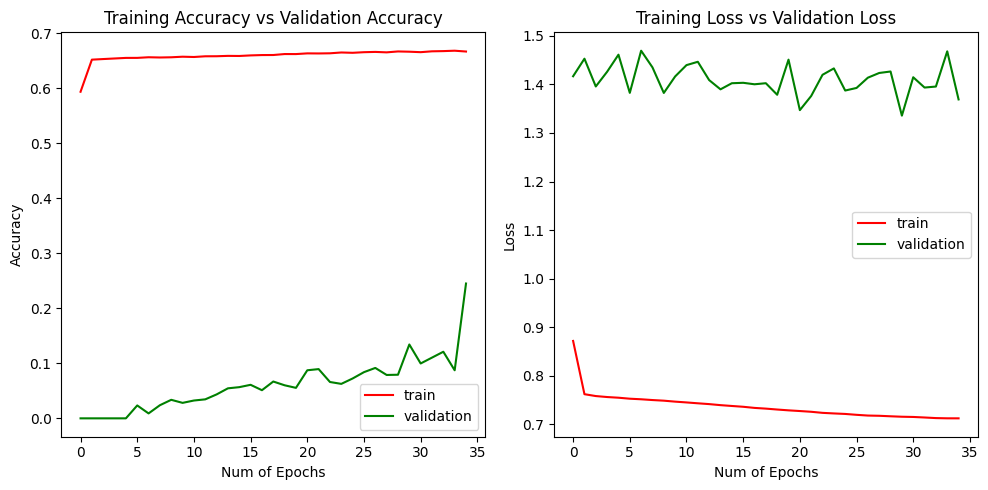

In [59]:
_, ax = plt.subplots(1, 2, figsize=(10, 5), dpi=100)
ax[0].plot(history.history['acc'], 'r')
ax[0].plot(history.history['val_acc'], 'g')
ax[0].set_xlabel("Num of Epochs")
ax[0].set_ylabel("Accuracy")
ax[0].set_title("Training Accuracy vs Validation Accuracy")
ax[0].legend(['train', 'validation'])

ax[1].plot(history.history['loss'], 'r')
ax[1].plot(history.history['val_loss'], 'g')
ax[1].set_xlabel("Num of Epochs")
ax[1].set_ylabel("Loss")
ax[1].set_title("Training Loss vs Validation Loss")
ax[1].legend(['train', 'validation'])

plt.tight_layout()

In [60]:
y_hat = model.predict(x=dfinput_x)
y_hat

733/733 [==============================] - 1s 1ms/step


array([[0.4235885 , 0.00963004, 0.5667814 ],
       [0.49008292, 0.02139542, 0.48852164],
       [0.45756593, 0.0242387 , 0.5181954 ],
       ...,
       [0.49137634, 0.00422156, 0.50440216],
       [0.20636143, 0.43617076, 0.35746783],
       [0.13984492, 0.53280395, 0.32735112]], dtype=float32)

In [61]:
y_pred_label = np.argmax(y_hat, axis = 1)
y_true_label = np.argmax(dfinput_y, axis = 1)

In [62]:
y_pred_label

array([2, 0, 2, ..., 2, 1, 1])

In [63]:
unique, counts = np.unique(y_pred_label, return_counts=True)
result = np.column_stack((unique, counts))
result

array([[    0,  7877],
       [    1, 11382],
       [    2,  4195]])

In [64]:
y_true_label

array([0, 0, 0, ..., 2, 2, 2])

In [65]:
unique, counts = np.unique(y_true_label, return_counts=True)
result = np.column_stack((unique, counts))
result

array([[   0, 7818],
       [   1, 7818],
       [   2, 7818]])

In [66]:
tabla = pd.crosstab(y_pred_label, y_true_label)
tabla

col_0,0,1,2
row_0,,,
0,5143,107,2627
1,1216,7251,2915
2,1459,460,2276
